In [1]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, Polygon,MultiPolygon
from geoalchemy2 import Geometry, WKTElement
from sqlalchemy import create_engine
import psycopg2
import math
import psycopg2.extras
import json
import os
import numpy as np
import statistics
import scipy
import numpy as np
import seaborn as sns
import matplotlib as plt
import geojson
import plotly.express as px

from matplotlib import pyplot as plt

pd.options.display.max_rows = 25

# functions defined:
def create_wkt_element(geom, srid):
    if geom.geom_type == 'Polygon':
        geom = MultiPolygon([geom])
    if geom.geom_type == 'Point':
        geom = Point(geom)
    return WKTElement(geom.wkt, srid)
def z(measure,x):
    return (x-(sum(measure)/len(measure)))/statistics.stdev(measure)

def sigmoid(x):
    s = 1 / (1 + np.exp(-x))
    return s

In [2]:
# codes below are from tutorials
credentials = "Credentials.json"

def pgconnect(credential_filepath, db_schema="public"):
    with open(credential_filepath) as f:
        db_conn_dict = json.load(f)
        host       = db_conn_dict['host']
        db_user    = db_conn_dict['user']
        db_pw      = db_conn_dict['password']
        default_db = db_conn_dict['user']
        try:
            db = create_engine('postgresql+psycopg2://'+db_user+':'+db_pw+'@'+host+'/'+default_db, echo=False)
            conn = db.connect()
            print('Connected successfully.')
        except Exception as e:
            print("Unable to connect to the database.")
            print(e)
            db, conn = None, None
        return db,conn

def query(conn, sqlcmd, args=None, df=True):
    result = pd.DataFrame() if df else None
    try:
        if df:
            result = pd.read_sql_query(sqlcmd, conn, params=args)
        else:
            result = conn.execute(sqlcmd, args).fetchall()
            result = result[0] if len(result) == 1 else result
    except Exception as e:
        print("Error encountered: ", e, sep='\n')
    return result

db, conn = pgconnect(credentials)

Connected successfully.


# Dataset

## Data clean

In [3]:
# Data clean for neighbour table:
neighbour_df = pd.read_csv("Data/Neighbourhoods.csv")
neighbour_df.rename (columns = {'Unnamed: 0':'neighbour_id','0-4':'zero_to_four','5-9':'five_to_nine','10-14':'ten_to_fourteen','15-19':'fifteen_to_nighteen'}, inplace = True)
# add additional column to count total number of young people
neighbour_df['young_people'] = neighbour_df[['zero_to_four','five_to_nine','ten_to_fourteen','fifteen_to_nighteen']].sum(axis = 1)
# drop na
neighbour_df.dropna(inplace = True)
# replace ',' with "" in numeric values and convert to int
neighbour_df['number_of_dwellings'] = neighbour_df['number_of_dwellings'].str.replace(',' , '').astype(int)
neighbour_df['population'] = neighbour_df['population'].str.replace(',' , '').astype(int)
neighbour_df.columns = neighbour_df.columns.map(lambda x: x.lower())

# Data clean for business table:
business_df = pd.read_csv("Data/BusinessStats.csv")
business_df.columns = business_df.columns.map(lambda x: x.lower())
business_df.dropna(inplace = True)


srid = 4283

# Data clean for SA2 TABLE
sa2_gdf = gpd.read_file('Data/SA2_2016_AUST.shp')
sa2_gdf.dropna(inplace = True)
# create geometry column of SA2: converting polygon to multipolygon

sa2_gdf['geom'] = sa2_gdf['geometry'].apply(lambda x: create_wkt_element(x, srid))
sa2_gdf = sa2_gdf.drop(columns = ['geometry'])
sa2_gdf = sa2_gdf[sa2_gdf['GCC_NAME16'] == 'Greater Sydney'] # aonii
sa2_gdf['GCC_NAME16'].unique() # aonii
sa2_gdf.columns = sa2_gdf.columns.map(lambda x: x.lower())


In [4]:
sa2_great_sydney_list = sa2_gdf['sa2_main16'].tolist()
neighbour_df = neighbour_df[neighbour_df['area_id'].astype(str).isin(sa2_great_sydney_list)]
business_df = business_df[business_df['area_id'].astype(str).isin(sa2_great_sydney_list)]

In [5]:
# Data clean for BreakEnterDwelling table
brk_gdf = gpd.read_file("Data/BreakEnterDwelling_JanToDec2021.shp")
brk_gdf.dropna(inplace=True)
brk_gdf.columns = brk_gdf.columns.map(lambda x: x.lower())
#brk_gdf2 = brk_gdf.copy()
brk_gdf['geom']= brk_gdf['geometry'].apply(lambda x: create_wkt_element(x, srid))
brk_gdf = brk_gdf.drop(columns=['geometry'])


# Data clean for 3 school tables
# 3x school catchment table
cat_primary_gdf = gpd.read_file(os.path.join("Data/catchments_primary.shp"))
cat_secondary_gdf = gpd.read_file(os.path.join("Data/catchments_secondary.shp"))
cat_future_gdf = gpd.read_file(os.path.join("Data/catchments_future.shp"))

#cat_primary_gdf.dropna(inplace=True)
cat_primary_gdf.columns = cat_primary_gdf.columns.map(lambda x: x.lower())
#cat_primary_gdf2 = cat_primary_gdf.copy()
cat_primary_gdf['geom']= cat_primary_gdf['geometry'].apply(lambda x: create_wkt_element(x, srid))
cat_primary_gdf= cat_primary_gdf.drop(columns=['priority']) # drop unused columns
cat_primary_gdf= cat_primary_gdf.drop(columns=['geometry'])


# cat_secondary_gdf.dropna(inplace=True)
cat_secondary_gdf.columns = cat_secondary_gdf.columns.map(lambda x: x.lower())
cat_secondary_gdf2 = cat_secondary_gdf.copy()
cat_secondary_gdf['geom']= cat_secondary_gdf['geometry'].apply(lambda x: create_wkt_element(x, srid))
cat_secondary_gdf= cat_secondary_gdf.drop(columns=['priority'])
cat_secondary_gdf= cat_secondary_gdf.drop(columns=['geometry'])

# cat_future_gdf.dropna(inplace=True)
cat_future_gdf.columns = cat_future_gdf.columns.map(lambda x: x.lower())
cat_future_gdf2 = cat_future_gdf.copy()
cat_future_gdf['geom']= cat_future_gdf['geometry'].apply(lambda x: create_wkt_element(x, srid))
cat_future_gdf= cat_future_gdf.drop(columns=['geometry'])

# append all 3 school tables
cat_future_gdf['isfuture'] = 1
cat_primary_gdf['isfuture'] = 0
cat_secondary_gdf['isfuture'] = 0
school_total = cat_primary_gdf.append(cat_secondary_gdf).append(cat_future_gdf)

/var/folders/z8/zm1gct552gb8700n_kq3pm9h0000gn/T/ipykernel_74129/3383989166.py:41: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  school_total = cat_primary_gdf.append(cat_secondary_gdf).append(cat_future_gdf)
/var/folders/z8/zm1gct552gb8700n_kq3pm9h0000gn/T/ipykernel_74129/3383989166.py:41: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  school_total = cat_primary_gdf.append(cat_secondary_gdf).append(cat_future_gdf)


In [6]:
# there are >100 duplicate use_id in the combined school catchment dataset, indicating some schools have both primary and secondary school.
# for those that have both primary and secondary schools, we will treat them as separate schools
# therefore a new column `school_catchment_id` is created to indicate the school id instead of using 'use_id'
school_total['school_catchment_id'] = [x for x in range(1, len(school_total) + 1)]


## upload dataset

In [7]:
isExist = False

In [8]:
# upload table to database

if isExist == False:
    neighbour_df.to_sql('neighbourhood', conn, if_exists = 'replace', index = False)
    business_df.to_sql('business', conn, if_exists = 'replace', index = False)
    sa2_gdf.to_sql('sa2', conn, if_exists = 'replace', index = False, dtype = {'geom': Geometry(geometry_type = 'MULTIPOLYGON', srid = srid)})
    brk_gdf.to_sql('break', conn, if_exists = 'replace', index = False, dtype = {'geom': Geometry(geometry_type = 'MULTIPOLYGON', srid = srid)})
    school_total.to_sql('school_total', conn, if_exists = 'replace', index = False, dtype = {'geom': Geometry(geometry_type = 'MULTIPOLYGON', srid = srid)})

## Alter table schema

### Data type

In [9]:
# update sa2 table
sql_sa2_schema = """
ALTER TABLE sa2 
ALTER COLUMN sa2_main16 type text,
ALTER COLUMN sa2_5dig16 type text,
ALTER COLUMN sa3_code16 type text,
ALTER COLUMN sa4_code16 type text,
ALTER COLUMN ste_code16 type text;
"""
query(conn, sql_sa2_schema)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [10]:
sql_neighbour_schema = """
ALTER TABLE neighbourhood 
ALTER COLUMN neighbour_id type text,
ALTER COLUMN area_id type text;
"""
query(conn, sql_neighbour_schema)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [11]:
sql_business_schema = """
ALTER TABLE business
ALTER COLUMN area_id type text;
"""
query(conn, sql_business_schema)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [12]:
sql_school_schema = """
ALTER TABLE school_total
ALTER COLUMN add_date type date USING add_date::date;
"""
query(conn, sql_school_schema)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [13]:
sql_check = """ SELECT column_name, 
                       data_type
                FROM information_schema.columns
                WHERE table_name = 'sa2';
"""
query(conn, sql_check)

,column_name,data_type
0,sa2_main16,text
1,sa2_5dig16,text
2,sa2_name16,text
3,sa3_code16,text
4,sa3_name16,text
5,sa4_code16,text
6,sa4_name16,text
7,gcc_code16,text
8,gcc_name16,text
9,ste_code16,text


### Keys

In [14]:
# update sa2 table
sql_sa2_schema = """
ALTER TABLE sa2 
ADD primary key (sa2_main16);
"""
query(conn, sql_sa2_schema)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [15]:
# update neighbourhood table
sql = """
ALTER TABLE neighbourhood 
ADD primary key (neighbour_id),
ADD foreign key (area_id) references sa2(sa2_main16);
"""
query(conn, sql)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [16]:
# update business table
sql = """
ALTER TABLE business 
ADD primary key (area_id),
ADD foreign key (area_id) references sa2(sa2_main16);
"""
query(conn, sql)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [17]:
# update school table
sql = """ 
ALTER TABLE school_total 
ADD primary key (school_catchment_id);
"""
query(conn, sql)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [18]:
# update break table
sql = """ 
ALTER TABLE break 
ADD primary key (objectid);
"""
query(conn, sql)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [27]:
#query to check foreign key and primary key
sql = """
SELECT
   tc.constraint_name, tc.table_name, kcu.column_name, 
   ccu.table_name AS foreign_table_name,
   ccu.column_name AS foreign_column_name,
   tc.is_deferrable,tc.initially_deferred
 FROM
   information_schema.table_constraints AS tc 
   JOIN information_schema.key_column_usage AS kcu ON tc.constraint_name = kcu.constraint_name
   JOIN information_schema.constraint_column_usage AS ccu ON ccu.constraint_name = tc.constraint_name
 WHERE (constraint_type = 'FOREIGN KEY' OR constraint_type = 'PRIMARY KEY') AND tc.table_name = 'school_total';
"""
query(conn, sql)

,constraint_name,table_name,column_name,foreign_table_name,foreign_column_name,is_deferrable,initially_deferred
0,school_total_pkey,school_total,school_catchment_id,school_total,school_catchment_id,NO,NO


In [19]:
sql = """ SELECT * 
          FROM sa2 
          WHERE sa2_main16 = '101051540';
"""
sql = """ SELECT * 
          FROM neighbourhood 
          WHERE area_id = '101051540';
"""
query(conn, sql)

,neighbour_id,area_id,area_name,land_area,population,number_of_dwellings,number_of_businesses,median_annual_household_income,avg_monthly_rent,zero_to_four,five_to_nine,ten_to_fourteen,fifteen_to_nighteen,young_people


## Additional Dataset

In [20]:
# additional datset: security camera

# additional_files=['Street_safety_cameras.geojson','FES_Industry_of_occupation.geojson']

# open and load cameras geojson file
camera_gdf = gpd.read_file("data/Street_safety_cameras.geojson", geometry = 'geometry')
camera_gdf.dropna(inplace = True)
camera_gdf['geom'] = camera_gdf['geometry'].apply(lambda x: create_wkt_element(x, srid))
camera_gdf.drop(columns = ['geometry'],inplace = True)
camera_gdf.columns = camera_gdf.columns.map(lambda x: x.lower())

# flatten 3d geometry points into 2d points
industry_gdf = gpd.read_file("data/FES_Industry_of_occupation.geojson", geometry = 'geometry')
industry_gdf.dropna(inplace = True)
industry_gdf['geometry_2d'] = gpd.points_from_xy(industry_gdf['geometry'].x,industry_gdf['geometry'].y)
industry_gdf['geom'] = industry_gdf['geometry_2d'].apply(lambda x: create_wkt_element(x, srid))
industry_gdf.drop(columns = ['geometry_2d'],inplace = True)
industry_gdf.drop(columns = ['geometry'],inplace = True)
industry_gdf.columns = industry_gdf.columns.map(lambda x: x.lower())


# additional dataset
price_df = pd.read_csv("data/sydney_city_2bed_unit.csv")
price_df.dropna(inplace = True)
price_df.columns = price_df.columns.map(lambda x: x.lower())


,sa2_name16,suburb,median_price
0,Darlinghurst,Darlinghurst,1650.0
1,Erskineville - Alexandria,Erskineville,1025.0
2,Erskineville - Alexandria,Alexandria,995.0
3,Glebe - Forest Lodge,Glebe,1208.0
4,Glebe - Forest Lodge,Forest Lodge,1300.0
5,Newtown - Camperdown - Darlington,Newtown,1053.0
6,Newtown - Camperdown - Darlington,Camperdown,1170.0
7,Newtown - Camperdown - Darlington,Darlington,1130.0
8,Potts Point - Woolloomooloo,Potts Point,1505.0
9,Potts Point - Woolloomooloo,Woolloomooloo,1650.0


In [26]:
# crate a new column `price_id` 
price_df['price_id'] = [x for x in range(1, len(price_df) + 1)]
price_df

,sa2_name16,suburb,median_price,price_id
0,Darlinghurst,Darlinghurst,1650.0,1
1,Erskineville - Alexandria,Erskineville,1025.0,2
2,Erskineville - Alexandria,Alexandria,995.0,3
3,Glebe - Forest Lodge,Glebe,1208.0,4
4,Glebe - Forest Lodge,Forest Lodge,1300.0,5
5,Newtown - Camperdown - Darlington,Newtown,1053.0,6
6,Newtown - Camperdown - Darlington,Camperdown,1170.0,7
7,Newtown - Camperdown - Darlington,Darlington,1130.0,8
8,Potts Point - Woolloomooloo,Potts Point,1505.0,9
9,Potts Point - Woolloomooloo,Woolloomooloo,1650.0,10


In [27]:

if isExist == False:
    camera_gdf.to_sql('camera', conn, if_exists = 'replace', index = False, dtype = {'geom': Geometry('POINT',4283)})
    industry_gdf.to_sql('industry', conn, if_exists = 'replace', index = False, dtype = {'geom': Geometry('POINT',4283)})
    price_df.to_sql('price', conn, if_exists = 'replace', index = False)

In [36]:
# update camera table
sql = """ 
ALTER TABLE camera
ADD primary key (objectid);
"""
query(conn, sql)

Error encountered: 
This result object does not return rows. It has been closed automatically.


""


In [42]:
# update price table
sql = """ 
ALTER TABLE price
ADD primary key (price_id);
"""
query(conn, sql)

Error encountered: 
(psycopg2.errors.InvalidTableDefinition) multiple primary keys for table "price" are not allowed

[SQL:  
ALTER TABLE price
ADD primary key (price_id)
]
(Background on this error at: https://sqlalche.me/e/14/f405)


""


## Index

In [28]:
# SA2 table
sql = """ CREATE INDEX sa2_geom_idx ON sa2 USING gist(geom); """
query(conn, sql)

sql = """ CREATE INDEX sa2_main16_idx ON sa2(sa2_main16); """
query(conn, sql)

# neighbourhood table
sql = """ CREATE INDEX neighbourhood_area_idx ON neighbourhood(area_id); """
query(conn, sql)

# business table
sql = """ CREATE INDEX business_area_idx ON business(area_id); """
query(conn, sql)

# school table
sql = """ CREATE INDEX school_geom_idx ON school_total USING gist(geom); """
query(conn, sql)

# industry table
sql = """ CREATE INDEX industry_geom_idx ON industry USING gist(geom); """
query(conn, sql)


Error encountered: 
(psycopg2.errors.DuplicateTable) relation "sa2_geom_idx" already exists

[SQL:  CREATE INDEX sa2_geom_idx ON sa2 USING gist(geom); ]
(Background on this error at: https://sqlalche.me/e/14/f405)
Error encountered: 
(psycopg2.errors.DuplicateTable) relation "sa2_main16_idx" already exists

[SQL:  CREATE INDEX sa2_main16_idx ON sa2(sa2_main16); ]
(Background on this error at: https://sqlalche.me/e/14/f405)
Error encountered: 
(psycopg2.errors.DuplicateTable) relation "neighbourhood_area_idx" already exists

[SQL:  CREATE INDEX neighbourhood_area_idx ON neighbourhood(area_id); ]
(Background on this error at: https://sqlalche.me/e/14/f405)
Error encountered: 
(psycopg2.errors.DuplicateTable) relation "business_area_idx" already exists

[SQL:  CREATE INDEX business_area_idx ON business(area_id); ]
(Background on this error at: https://sqlalche.me/e/14/f405)
Error encountered: 
(psycopg2.errors.DuplicateTable) relation "school_geom_idx" already exists

[SQL:  CREATE INDEX 

""


# Task 2

## School

In [30]:
sql_school_count = """ SELECT s.sa2_main16, 
                              count(t.use_id) AS "number_of_schools",
                              n.young_people
                       FROM sa2 s JOIN school_total t ON st_intersects(s.geom, t.geom)
                            JOIN neighbourhood n ON (s.sa2_main16 = n.area_id)
                       WHERE t.isfuture::integer = 0
                       GROUP BY s.sa2_main16, n.young_people
                       ORDER BY number_of_schools DESC;
"""
#query(conn, sql_school_count)
school_res = pd.read_sql_query(sql_school_count, conn)


In [31]:
#school_res['outlier']=school_res.isna()
#school_res.fillna(0,inplace=True)
school_res['z_school'] = school_res['number_of_schools']/(school_res['young_people']/1000)
# replace z_school inf with 0
#school_res['z_school'].replace([np.inf, -np.inf], 0, inplace=True)
school_res.sort_values(by = 'z_school', ascending = False)

,sa2_main16,number_of_schools,young_people,z_school
246,127011592,8,13,615.384615
229,119011355,9,246,36.585366
3,102011030,27,1098,24.590164
138,115031299,13,616,21.103896
67,102021049,16,956,16.736402
...,...,...,...,...
228,119011357,9,8646,1.040944
282,102011040,5,5254,0.951656
296,122021420,3,3248,0.923645
278,122021423,6,6625,0.905660


## Crime

In [32]:
sql_crime_sum = """ SELECT sa2_main16, 
                           n.land_area, 
                           SUM(st_area(st_intersection(s.geom,b.geom))) AS "sum_intersection_area"
                    FROM sa2 s JOIN neighbourhood n ON (n.area_id = s.sa2_main16) 
                        JOIN break b ON st_intersects(s.geom, b.geom)
                    GROUP BY sa2_main16, n.land_area;
"""
crime_res = pd.read_sql_query(sql_crime_sum, conn)

In [33]:
# replace na with 0
#crime_res.fillna(0,inplace=True)
crime_res['z_crime'] = crime_res['sum_intersection_area']/(crime_res['land_area'])
# replace z_school inf with 0
#crime_res['z_crime'].replace([np.inf, -np.inf], 0, inplace=True)
crime_res.sort_values(by='z_crime', ascending=False)


,sa2_main16,land_area,sum_intersection_area,z_crime
72,117031336,131.6,0.000377,2.865467e-06
71,117031335,216.3,0.000579,2.675517e-06
67,117031331,230.2,0.000569,2.471255e-06
65,117031329,85.7,0.000200,2.336290e-06
230,125041589,393.6,0.000862,2.190108e-06
...,...,...,...,...
38,115031300,33185.0,0.000010,3.076941e-10
185,123031446,28994.6,0.000006,2.026974e-10
36,115021297,37754.0,0.000006,1.483709e-10
17,102021049,34676.6,0.000005,1.468079e-10


## Accomm, Retail, Health

In [34]:
sql_acc_ret_heal = ''' SELECT n.area_id,
                              n.median_annual_household_income, 
                              n.avg_monthly_rent,
                              (b.accommodation_and_food_services) AS accomm,
                              (b.retail_trade) AS retail,
                              (b.health_care_and_social_assistance) AS health,
                              (n.population) AS population
                       FROM neighbourhood n JOIN business b ON (n.area_id = b.area_id);
         '''
acc_ret_heal_res = pd.read_sql_query(sql_acc_ret_heal, conn)
#score = pd.merge(score, crime, how = 'Inner', on = 'area_id')
acc_ret_heal_res.rename(columns = {'area_id':'sa2_main16'}, inplace = True)

In [43]:
acc_ret_heal_res['z_accomm'] = acc_ret_heal_res['accomm']/(acc_ret_heal_res['population']/1000)
acc_ret_heal_res['z_retail'] = acc_ret_heal_res['retail']/(acc_ret_heal_res['population']/1000)
acc_ret_heal_res['z_health'] = acc_ret_heal_res['health']/(acc_ret_heal_res['population']/1000)
acc_ret_heal_res.head()

,sa2_main16,median_annual_household_income,avg_monthly_rent,accomm,retail,health,population,z_accomm,z_retail,z_health
0,102011028,46996.0,1906.0,33,35,60,7590,4.347826,4.611331,7.905138
1,102011029,42621.0,1682.0,23,45,43,10986,2.093574,4.096122,3.914072
2,102011030,42105.0,1182.0,14,43,12,4841,2.891964,8.882462,2.478827
3,102011031,43481.0,1595.0,68,145,179,14237,4.776287,10.184730,12.572873
4,102011032,45972.0,1382.0,94,167,246,19385,4.849110,8.614908,12.690224


## Z-score

In [44]:

#acc_ret_heal_res.dtypes
#crime_res.dtypes
z_table = pd.merge(crime_res, acc_ret_heal_res, how = 'inner', on = 'sa2_main16')
z_table = pd.merge(z_table, school_res, how = 'inner', on = 'sa2_main16')
z_table2 = z_table.drop(columns = ['young_people','land_area','number_of_schools','sum_intersection_area','accomm','retail','health','population'])

z_table2['livable_score'] = sigmoid(scipy.stats.zscore(z_table2['z_school']) +
                              scipy.stats.zscore(z_table2['z_accomm']) +
                              scipy.stats.zscore(z_table2['z_retail']) -
                              scipy.stats.zscore(z_table2['z_crime']) +
                              scipy.stats.zscore(z_table2['z_health']))


### Correlations

In [45]:
# Pearson's correlation coefficient
corr_income = z_table2[['median_annual_household_income','livable_score']].corr()
corr_rent = z_table2[['avg_monthly_rent','livable_score']].corr()
print(f"The correlation between median annual household income and livable score is {round(corr_income['median_annual_household_income']['livable_score'],3)}\nThe correlation between average monthly rent and livable score is {round(corr_rent['avg_monthly_rent']['livable_score'],3)}")

The correlation between median annual household income and livable score is 0.281
The correlation between average monthly rent and livable score is 0.425


median_annual_household_income = 7484.19*(livable score) + 46478.111 with R-squared value of 0.079
avg_monthly_rent = 638.644livable_score + 1672.575 with R-squared value of 0.181


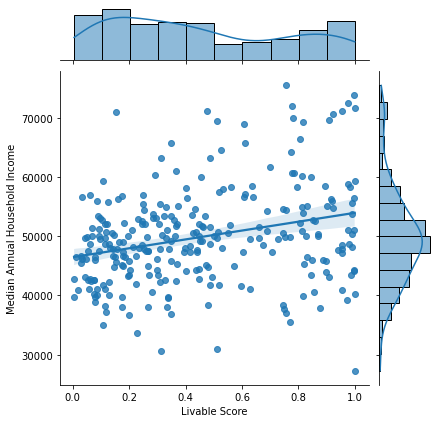

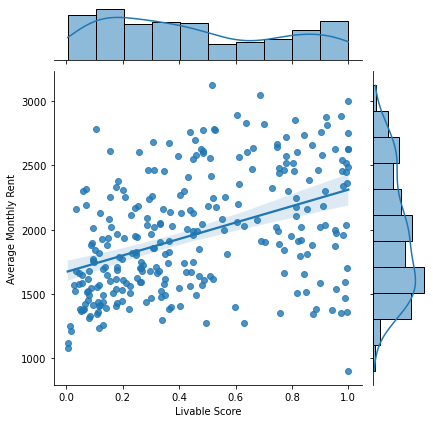

In [49]:
# create subplots for correlation scatter plot
# fig, axes = plt.subplots(1,2, figsize = (20, 10))
# fig.suptitle('Livable Score Correlation Tests (Great Sydney Region)', fontsize = 25)
# axes[0].set_title('Correlation with Median Annual Household Income', fontsize = 20)
# axes[1].set_title('Correlation with Average Monthly Rent', fontsize = 20)
sns.jointplot(data = z_table2, x = 'livable_score', y = 'median_annual_household_income',kind='reg').set_axis_labels('Livable Score', 'Median Annual Household Income')
sns.jointplot(data = z_table2, x = 'livable_score', y = 'avg_monthly_rent',kind='reg').set_axis_labels('Livable Score', 'Average Monthly Rent')


slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(z_table2['livable_score'], z_table2['median_annual_household_income'])
print(f"median_annual_household_income = {round(slope,3)}*(livable score) + {round(intercept,3)} with R-squared value of {round(r_value**2,3)}")


slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(z_table2['livable_score'], z_table2['avg_monthly_rent'])
print(f"avg_monthly_rent = {round(slope,3)}livable_score + {round(intercept,3)} with R-squared value of {round(r_value**2,3)}")

### Livable score dataset upload

In [41]:

if isExist == False:
    z_table2.to_sql('z_table', conn, if_exists = 'replace', index = False)

### Visualisation of livable scores

In [42]:
sql_vis = """ SELECT z.sa2_main16, 
                     s.sa2_name16, 
                     z.livable_score,
                     s.geom
              FROM z_table z JOIN sa2 s ON (z.sa2_main16 = s.sa2_main16);
"""

vis_gdf = gpd.read_postgis(sql_vis, conn, geom_col = 'geom')

<AxesSubplot:>

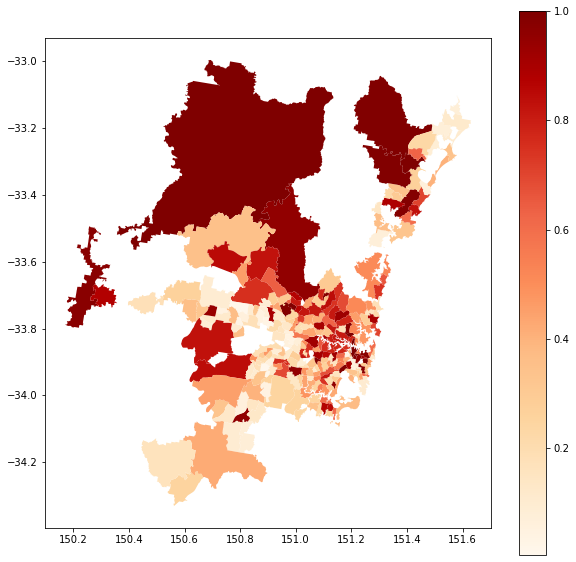

In [43]:
vis_gdf.plot(column = 'livable_score', cmap = 'OrRd', figsize = (10,10), legend = True)

In [261]:
# interactive plot
vis_gdf_2 = vis_gdf.copy()
fig = px.choropleth_mapbox(vis_gdf_2, geojson = vis_gdf_2.geometry, locations = vis_gdf_2.index, color = 'livable_score',
                           color_continuous_scale = "Viridis",
                           range_color = (0, 1),
                           mapbox_style = "carto-positron",
                           center = {'lat': -33.5788, 'lon': 150.9999},
                           opacity = 0.5,
                           zoom = 8,
                           width = 1000,
                           height = 800)
fig.update_geos(fitbounds = 'locations', visible = False)
fig.show()

In [45]:
# find regions with highest score and lowest score regions
max_score_gsyd = vis_gdf_2['livable_score'].max()
max_name = vis_gdf_2[vis_gdf_2['livable_score'] == max_score_gsyd]['sa2_name16'].values[0]
min_score_gsyd = vis_gdf_2['livable_score'].min()
min_name = vis_gdf_2[vis_gdf_2['livable_score'] == min_score_gsyd]['sa2_name16'].values[0]
avg_score_gsyd = vis_gdf_2['livable_score'].mean()
print(f"GREATER SYDNEY Liveable Scores:\nMax score found on {max_name} region: {round(max_score_gsyd,3)} \nMin score found on {min_name} region: {round(min_score_gsyd,3)}\nAverage score: {round(avg_score_gsyd,3)}")

GREATER SYDNEY Liveable Scores:
Max score found on Sydney - Haymarket - The Rocks region: 1.0 
Min score found on Bidwill - Hebersham - Emerton region: 0.005
Average score: 0.45


# Task 3

## Additional dataset: Camera

In [46]:
sql_camera_count= """ SELECT s.sa2_main16, 
                             s.sa2_name16,s.areasqkm16,  
							 COUNT(c.objectid) AS "camera_count_sum", 
							 z.z_crime, 
							 z.livable_score
	                  FROM sa2 s LEFT JOIN camera c ON st_intersects(s.geom, c.geom) 
					  	  LEFT JOIN z_table z ON (z.sa2_main16 = s.sa2_main16)
	                  WHERE sa3_name16 = 'Sydney Inner City'
	                  GROUP BY s.sa2_main16, s.sa2_name16,z.livable_score,z.z_crime, s.areasqkm16;
"""
camera_city_count_df = pd.read_sql_query(sql_camera_count, conn)

In [47]:
sql_sa2_city = """ SELECT sa2_main16, 
                          sa2_name16, 
                          geom
                   FROM sa2
                   WHERE sa3_name16 = 'Sydney Inner City';
"""
sa2_city_gdf = gpd.read_postgis(sql_sa2_city, conn, geom_col = 'geom')

In [48]:
sql = """ SELECT sa2_main16,
                 areasqkm16, 
                 n.land_area
          FROM sa2 s JOIN neighbourhood n ON (s.sa2_main16 = n.area_id)
          LIMIT 5;
"""
query(conn,sql)

,sa2_main16,areasqkm16,land_area
0,102011028,6.4376,643.8
1,102011029,32.0860,3208.6
2,102011030,767.9512,76795.1
3,102011031,33.7934,3379.3
4,102011032,16.9124,1691.2


In [49]:
camera_city_count_df['z_camera'] = camera_city_count_df['camera_count_sum']/(camera_city_count_df['areasqkm16'])
camera_city_count_df


,sa2_main16,sa2_name16,areasqkm16,camera_count_sum,z_crime,livable_score,z_camera
0,117031329,Darlinghurst,0.8569,8,2.336290e-06,0.999864,9.335979
1,117031330,Erskineville - Alexandria,4.3200,0,1.068468e-06,0.908049,0.000000
2,117031331,Glebe - Forest Lodge,2.3018,1,2.471255e-06,0.032434,0.434443
3,117031332,Newtown - Camperdown - Darlington,3.2812,1,2.031363e-06,0.401821,0.304767
4,117031333,Potts Point - Woolloomooloo,1.4591,20,1.791517e-06,0.562830,13.707080
5,117031334,Pyrmont - Ultimo,1.4913,1,1.690779e-06,0.395114,0.670556
6,117031335,Redfern - Chippendale,2.1631,1,2.675517e-06,0.069215,0.462299
7,117031336,Surry Hills,1.3164,3,2.865467e-06,0.982269,2.278943
8,117031337,Sydney - Haymarket - The Rocks,4.2934,71,6.739940e-07,1.000000,16.537010
9,117031338,Waterloo - Beaconsfield,3.5809,0,1.989819e-06,0.060236,0.000000


In [50]:
camera_city_count_df[['z_crime','camera_count_sum']].corr()

,z_crime,camera_count_sum
z_crime,1.000000,-0.639892
camera_count_sum,-0.639892,1.000000


<AxesSubplot:xlabel='livable_score', ylabel='camera_count_sum'>

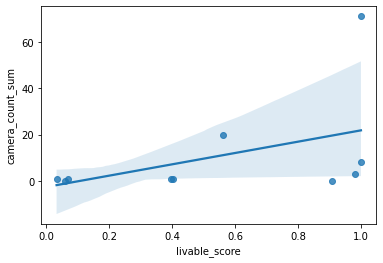

In [51]:
sns.regplot(data = camera_city_count_df, x = 'livable_score', y = 'camera_count_sum')

## Additional dataset: Industry

In [52]:
sql_industry=""" SELECT s.sa2_main16, 
                        s.sa2_name16, 
                        i.industryname, 
                        i.citybasedindustry, 
                        z.livable_score, 
                        i.geom
                 FROM industry i JOIN sa2 s ON ST_INTERSECTS(i.geom, s.geom)
                     JOIN z_table z ON (z.sa2_main16 = s.sa2_main16);
"""
industry_res = gpd.read_postgis(sql_industry, conn, geom_col = 'geom')

In [53]:
sql_industry_count =""" SELECT s.sa2_main16, 
                               s.sa2_name16, 
                               i.citybasedindustry, 
                               COUNT(i.citybasedindustry) AS "number_of_industry"
                        FROM industry i JOIN sa2 s ON ST_INTERSECTS(i.geom, s.geom)
                        GROUP BY s.sa2_main16, s.sa2_name16, i.citybasedindustry;
"""

industry_count_res = pd.read_sql_query(sql_industry_count, conn)

In [54]:
# there are 19 different industry in the city
total_type_industry = len(industry_count_res['citybasedindustry'].unique())

# for each type of industry, calculate the total number of buidlings (point) of that industry 
# use a dictionary to record this information:
# e.g., total 13 ICT industry building, 13 Food industry building, 13 Retail industry building.... 
each_industry_building_count = industry_count_res.groupby('citybasedindustry').sum('number_of_industry')
total_building_dict = {}
for i in range (0, len(each_industry_building_count)):
    total_building_dict[each_industry_building_count.index[i]] = each_industry_building_count.values[i][0]
#total_building_dict # dictionary we want use to calculate the percentage of each industry

# Drop columns that are highly correlated with existing Z scores:
total_building_dict.pop('Health')
total_building_dict.pop('Food and Drink')
total_building_dict.pop('Retail and Personal Services')

10044

In [55]:
industry_count_res['ratio'] = 0
industry_count_res['index_component'] = 0
for i in range(len(industry_count_res)):
    if (industry_res.loc[i,'citybasedindustry'] in total_building_dict):
        #print(industry_res.loc[i,'citybasedindustry'],industry_res.loc[i,'citybasedindustry'] in total_building_dict)
        if total_building_dict.get(industry_count_res.loc[i,'citybasedindustry']) != None:
            industry_count_res.loc[i,'ratio'] = (industry_count_res.loc[i,'number_of_industry'].astype(int)/total_building_dict.get(industry_count_res.loc[i,'citybasedindustry']).astype(int))
            industry_count_res.loc[i,'index_component'] =  (industry_count_res.loc[i,'number_of_industry']/total_building_dict.get(industry_count_res.loc[i,'citybasedindustry'])) ** 2
        else:
            industry_count_res.loc[i,'ratio'] = 0
            industry_count_res.loc[i,'index_component']=0
    else:
        industry_count_res.loc[i,'ratio'] = 0
        industry_count_res.loc[i,'index_component'] = 0
#z_table2['livable_score'] = sigmoid(scipy.stats.zscore(z_table2['z_school']) 
industry_index_df = industry_count_res.groupby('sa2_main16').sum()


In [56]:
                                    
#sigmoid(sp.stats.zscore(industry_count_res.groupby('sa2_name16').sum('index_component')['index_component']))
industry_index_df['z_industry_index'] = industry_index_df['index_component']
#industry_index_df['index2'] = sigmoid(sp.stats.zscore(industry_index_df['ratio']))
industry_index_df.reset_index(inplace = True)

## Additional dataset: Price

In [57]:
sql_price = """ SELECT s.sa2_main16, 
                       p.sa2_name16, 
                       AVG(median_price) AS "median_price_per_sa2_region(k)"
                FROM price p JOIN sa2 s ON s.sa2_name16 = p.sa2_name16
                GROUP BY p.sa2_name16, s.sa2_main16;
"""
#query(conn,sql_price)
price_df = pd.read_sql_query(sql_price,conn)
price_df

,sa2_main16,sa2_name16,median_price_per_sa2_region(k)
0,117031334,Pyrmont - Ultimo,1165.000000
1,117031337,Sydney - Haymarket - The Rocks,1307.500000
2,117031333,Potts Point - Woolloomooloo,1577.500000
3,117031329,Darlinghurst,1650.000000
4,117031336,Surry Hills,1343.000000
5,117031330,Erskineville - Alexandria,1010.000000
6,117031335,Redfern - Chippendale,1067.000000
7,117031332,Newtown - Camperdown - Darlington,1117.666667
8,117031338,Waterloo - Beaconsfield,950.000000
9,117031331,Glebe - Forest Lodge,1254.000000


In [58]:
city_sa2_id = industry_count_res['sa2_main16'].unique().tolist()

# industry_count_res['sa2_main16']=industry_count_res['sa2_main16'].astype(int)
z_table3 = pd.merge(z_table2[z_table2['sa2_main16'].isin(city_sa2_id)], industry_index_df, on = 'sa2_main16', how = "inner")
z_table3 = pd.merge(z_table3, camera_city_count_df, on = 'sa2_main16', how = "inner")
z_table3 = pd.merge(z_table3, price_df, on = 'sa2_name16', how = "inner")

### correlation between livable_score and industry_diversity_index

In [59]:
z_table3['z_industry_index'].corr(z_table3['livable_score_x'])
z_table3

,sa2_main16_x,z_crime_x,median_annual_household_income,avg_monthly_rent,z_accomm,z_retail,z_health,z_school,livable_score_x,number_of_industry,...,index_component,z_industry_index,sa2_name16,areasqkm16,camera_count_sum,z_crime_y,livable_score_y,z_camera,sa2_main16_y,median_price_per_sa2_region(k)
0,117031329,2.336290e-06,59293.0,2491.0,15.708072,12.083132,22.555180,13.447433,0.999864,2512,...,0.027335,0.027335,Darlinghurst,0.8569,8,2.336290e-06,0.999864,9.335979,117031329,1650.000000
1,117031330,1.068468e-06,69680.0,2581.0,7.799349,14.644821,6.284368,3.996448,0.908049,4213,...,0.351793,0.351793,Erskineville - Alexandria,4.3200,0,1.068468e-06,0.908049,0.000000,117031330,1010.000000
2,117031331,2.471255e-06,56691.0,2162.0,5.603927,5.372360,8.382734,2.934703,0.032434,2028,...,0.006884,0.006884,Glebe - Forest Lodge,2.3018,1,2.471255e-06,0.032434,0.434443,117031331,1254.000000
3,117031332,2.031363e-06,58210.0,2270.0,7.322404,5.974499,13.114754,4.198568,0.401821,2093,...,0.034353,0.034353,Newtown - Camperdown - Darlington,3.2812,1,2.031363e-06,0.401821,0.304767,117031332,1117.666667
4,117031333,1.791517e-06,58253.0,2256.0,8.400185,5.880129,6.636146,6.901311,0.562830,2506,...,0.033730,0.033730,Potts Point - Woolloomooloo,1.4591,20,1.791517e-06,0.562830,13.707080,117031333,1577.500000
5,117031334,1.690779e-06,47393.0,2575.0,9.591828,8.968982,6.934352,2.486679,0.395114,3433,...,0.047878,0.047878,Pyrmont - Ultimo,1.4913,1,1.690779e-06,0.395114,0.670556,117031334,1165.000000
6,117031335,2.675517e-06,51347.0,2193.0,5.599499,5.207925,5.051296,7.109005,0.069215,2791,...,0.030569,0.030569,Redfern - Chippendale,2.1631,1,2.675517e-06,0.069215,0.462299,117031335,1067.000000
7,117031336,2.865467e-06,58396.0,2342.0,15.223649,13.396811,11.403897,9.523810,0.982269,5914,...,0.116487,0.116487,Surry Hills,1.3164,3,2.865467e-06,0.982269,2.278943,117031336,1343.000000
8,117031337,6.739940e-07,27311.0,2998.0,54.337311,54.853273,39.245405,4.203286,1.000000,34882,...,3.682113,3.682113,Sydney - Haymarket - The Rocks,4.2934,71,6.739940e-07,1.000000,16.537010,117031337,1307.500000
9,117031338,1.989819e-06,57055.0,2302.0,6.090327,8.726832,4.060218,2.109300,0.060236,3052,...,0.209121,0.209121,Waterloo - Beaconsfield,3.5809,0,1.989819e-06,0.060236,0.000000,117031338,950.000000


## New livable score calculation

In [219]:
# livable_score_new = z_accomm+z_retail+z_health+z_school-z_crime+z_camera+z_industry

z_table3['z_accomm_norm'] = scipy.stats.zscore(z_table3['z_accomm'])
z_table3['z_retail_norm'] = scipy.stats.zscore(z_table3['z_retail'])
z_table3['z_health_norm'] = scipy.stats.zscore(z_table3['z_health'])
z_table3['z_school_norm'] = scipy.stats.zscore(z_table3['z_school'])
z_table3['z_crime_norm'] = scipy.stats.zscore(z_table3['z_crime_x'])
z_table3['z_camera_norm'] = scipy.stats.zscore(z_table3['z_camera'])
z_table3['z_industry_index_norm'] = scipy.stats.zscore(z_table3['z_industry_index'])
z_table3['z_price_norm'] = scipy.stats.zscore(z_table3['median_price_per_sa2_region(k)'])
z_table3['livable_score_new'] = sigmoid(1*z_table3['z_accomm_norm'] + z_table3['z_retail_norm'] + 
                                        3*z_table3['z_health_norm'] + 4*z_table3['z_school_norm'] - 
                                        2*z_table3['z_crime_norm'] + 2*z_table3['z_camera_norm'] + 
                                        z_table3['z_industry_index_norm'] - z_table3['z_price_norm'])
z_table3

,sa2_main16_x,z_crime_x,median_annual_household_income,avg_monthly_rent,z_accomm,z_retail,z_health,z_school,livable_score_x,number_of_industry,...,median_price_per_sa2_region(k),z_accomm_norm,z_retail_norm,z_health_norm,z_school_norm,z_crime_norm,z_camera_norm,z_industry_index_norm,z_price_norm,livable_score_new
0,117031329,2.336290e-06,59293.0,2491.0,15.708072,12.083132,22.555180,13.447433,0.999864,2512,...,1650.000000,0.152611,-0.100799,0.987029,2.274081,0.575330,0.823250,-0.394747,1.843339,0.999969
1,117031330,1.068468e-06,69680.0,2581.0,7.799349,14.644821,6.284368,3.996448,0.908049,4213,...,1010.000000,-0.411278,0.080057,-0.589259,-0.496839,-1.360266,-0.725419,-0.094579,-1.063610,0.136152
2,117031331,2.471255e-06,56691.0,2162.0,5.603927,5.372360,8.382734,2.934703,0.032434,2028,...,1254.000000,-0.567810,-0.574583,-0.385973,-0.808131,0.781383,-0.653352,-0.413667,0.044664,0.000142
3,117031332,2.031363e-06,58210.0,2270.0,7.322404,5.974499,13.114754,4.198568,0.401821,2093,...,1117.666667,-0.445284,-0.532072,0.072457,-0.437580,0.109795,-0.674863,-0.388255,-0.574577,0.019971
4,117031333,1.791517e-06,58253.0,2256.0,8.400185,5.880129,6.636146,6.901311,0.562830,2506,...,1577.500000,-0.368438,-0.538735,-0.555179,0.354833,-0.256380,1.548335,-0.388831,1.514036,0.634875
5,117031334,1.690779e-06,47393.0,2575.0,9.591828,8.968982,6.934352,2.486679,0.395114,3433,...,1165.000000,-0.283475,-0.320660,-0.526289,-0.939486,-0.410178,-0.614186,-0.375742,-0.359584,0.001718
6,117031335,2.675517e-06,51347.0,2193.0,5.599499,5.207925,5.051296,7.109005,0.069215,2791,...,1067.000000,-0.568126,-0.586193,-0.708716,0.415727,1.093231,-0.648732,-0.391755,-0.804710,0.009116
7,117031336,2.865467e-06,58396.0,2342.0,15.223649,13.396811,11.403897,9.523810,0.982269,5914,...,1343.000000,0.118072,-0.008053,-0.093288,1.123720,1.383229,-0.347384,-0.312269,0.448912,0.525635
8,117031337,6.739940e-07,27311.0,2998.0,54.337311,54.853273,39.245405,4.203286,1.000000,34882,...,1307.500000,2.906860,2.918794,2.603948,-0.436196,-1.962513,2.017769,2.986416,0.287667,1.000000
9,117031338,1.989819e-06,57055.0,2302.0,6.090327,8.726832,4.060218,2.109300,0.060236,3052,...,950.000000,-0.533130,-0.337756,-0.804730,-1.050129,0.046370,-0.725419,-0.226571,-1.336137,0.000363


In [220]:
z_table4 = z_table3.drop(columns = ['z_accomm',	'z_retail',	'z_health',	'z_school', 'z_crime_x', 'z_industry_index', 'z_camera', 'number_of_industry', 'index_component', 'ratio','areasqkm16', 'camera_count_sum', 'z_crime_y', 'livable_score_y'])

In [221]:
z_table4.drop(columns = ['sa2_main16_y', 'median_price_per_sa2_region(k)'], inplace = True)

In [224]:
z_table4.to_sql('z_table_sydney_city', conn, if_exists = 'replace', index = False)

10

In [225]:
sql_new_z = """
select z.sa2_main16_x, z.sa2_name16, z_accomm_norm,z_retail_norm, z_health_norm, z_school_norm, z_crime_norm, z_camera_norm, z_industry_index_norm, z_price_norm, livable_score_x as "old_livable_score", livable_score_new as "new_livable_score", s.geom 
from z_table_sydney_city z join sa2 s on z.sa2_main16_x = s.sa2_main16
"""

vis_new_gdf = gpd.GeoDataFrame.from_postgis(sql_new_z, conn, geom_col = 'geom')

## Correlations (City of Sydney)

In [226]:
# Pearson's correlation coefficient
corr_income = z_table4[['median_annual_household_income','livable_score_new']].corr()
corr_rent = z_table4[['avg_monthly_rent','livable_score_new']].corr()
print(f"The correlation between median annual household income and livable score is {round(corr_income['median_annual_household_income']['livable_score_new'],3)}\nThe correlation between average monthly rent and livable score is {round(corr_rent['avg_monthly_rent']['livable_score_new'],3)}")

The correlation between median annual household income and livable score is -0.367
The correlation between average monthly rent and livable score is 0.554


median_annual_household_income = -9685.804*(new_livable_score) + 57586.278 with R-squared value of 0.135
avg_monthly_rent = 333.735*(new_livable_score) + 2305.935 with R-squared value of 0.307


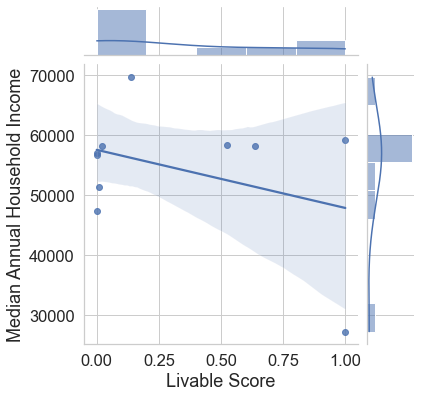

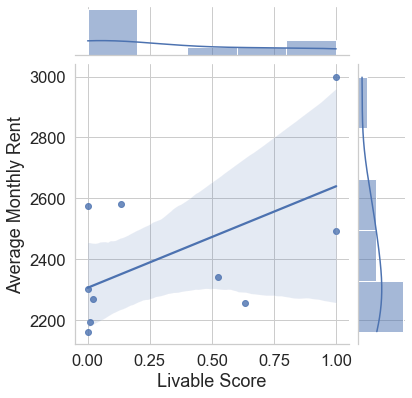

In [262]:
# create subplots for correlation scatter plot
# fig, axes = plt.subplots(1,2, figsize = (20, 10))
# fig.suptitle('Livable Score Correlation Tests (City of Sydney Region)', fontsize = 25)
# axes[0].set_title('Correlation with Median Annual Household Income', fontsize = 20)
# axes[1].set_title('Correlation with Average Monthly Rent', fontsize = 20)

sns.jointplot(ax=axes[0],x='livable_score_new', y='median_annual_household_income', data=z_table4, kind='reg').set_axis_labels('Livable Score', 'Median Annual Household Income')
sns.jointplot(ax=axes[1],x='livable_score_new', y='avg_monthly_rent', data=z_table4, kind='reg').set_axis_labels('Livable Score', 'Average Monthly Rent')

# sns.regplot(ax = axes[0],data = z_table4, x = 'livable_score_new', y = 'median_annual_household_income')
# sns.regplot(ax = axes[1],data = z_table4, x = 'livable_score_new', y = 'avg_monthly_rent')

#scipy.stats.pearsonr(z_table4['livable_score_new'], z_table4['median_annual_household_income'])
#scipy.stats.pearsonr(z_table4['livable_score_new'], z_table4['avg_monthly_rent'])

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(z_table4['livable_score_new'], z_table4['median_annual_household_income'])
print(f"median_annual_household_income = {round(slope,3)}*(new_livable_score) + {round(intercept,3)} with R-squared value of {round(r_value**2,3)}")


slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(z_table4['livable_score_new'], z_table4['avg_monthly_rent'])
print(f"avg_monthly_rent = {round(slope,3)}*(new_livable_score) + {round(intercept,3)} with R-squared value of {round(r_value**2,3)}")

## Visulisation

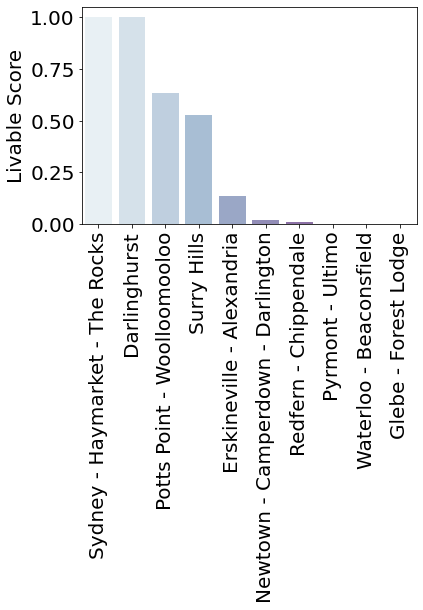

In [229]:
import adjustText as aT

# fig, ax = plt.subplots(figsize = (10,10))

# vis_new_gdf['centroid'] = vis_new_gdf['geom'].representative_point()
# vis_new_gdf_points = vis_new_gdf.copy()
# vis_new_gdf_points.set_geometry('centroid', inplace = True)
# #vis_new_gdf.plot(ax=ax, column = 'new_livable_score', cmap='BuPu', alpha =0.7, figsize=(10,10), legend = True,  edgecolor = 'black', linewidth = 1, markersize = 10)

# texts=[]
# for x, y, label in zip(vis_new_gdf_points.geometry.x, vis_new_gdf_points.geometry.y, vis_new_gdf_points['sa2_name16']):
#     texts.append(plt.text(x, y, label, fontsize = 10))
    
# aT.adjust_text(texts, force_points=1, force_text=1, expand_points=(3,3), expand_text=(3,3),arrowprops=dict(arrowstyle="<-", color='black', lw=1.5))

# vis_new_gdf_points.plot(ax=ax, color = 'red', markersize = 10, alpha = 0.5)


fig = px.choropleth_mapbox(vis_new_gdf, geojson = vis_new_gdf.geometry, locations = vis_new_gdf.index, color = 'new_livable_score',
                           color_continuous_scale = "Viridis",
                           range_color = (0, 1),
                           mapbox_style = "carto-positron",
                           center = {'lat': -33.889, 'lon': 151.1999},
                           opacity = 0.5,
                           zoom = 12,
                           width = 800,
                           height = 800)
fig.update_geos(fitbounds = 'locations', visible = False)
fig.show()

#plt.savefig('fig_new_z_score.png',dpi=300)

#
vis_new_gdf_sorted = vis_new_gdf.sort_values(by = 'new_livable_score', ascending = False)
bar=sns.barplot(x = 'sa2_name16', y = 'new_livable_score', data = vis_new_gdf_sorted, palette = 'BuPu')
bar.set(xlabel = None, ylabel = 'Livable Score')
for item in bar.get_xticklabels():
    item.set_rotation(90)

In [239]:
fig = px.choropleth_mapbox(vis_new_gdf, geojson = vis_new_gdf.geometry, locations = vis_new_gdf.index, color = 'old_livable_score',
                           color_continuous_scale = "Viridis",
                           range_color = (0, 1),
                           mapbox_style = "carto-positron",
                           center = {'lat': -33.889, 'lon': 151.1999},
                           opacity = 0.5,
                           zoom = 12,
                           width = 800,
                           height = 800)
fig.update_geos(fitbounds = 'locations', visible = False)
fig.show()

In [ ]:
# interactive plot
vis_new_gdf_2 = vis_new_gdf.copy()
fig = px.choropleth_mapbox(vis_new_gdf_2, geojson = vis_new_gdf_2.geometry, locations = vis_new_gdf_2.index, color = 'livable_score',
                           color_continuous_scale = "Viridis",
                           range_color = (0, 1),
                           mapbox_style = "carto-positron",
                           center = {'lat': -33.5788, 'lon': 150.9999},
                           opacity = 0.5,
                           zoom = 8,
                           width = 1500,
                           height = 800)
fig.update_geos(fitbounds = 'locations', visible = False)
fig.show()

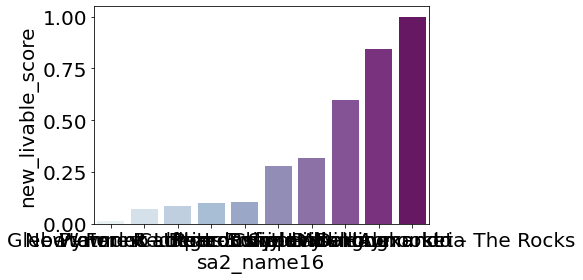

/var/folders/z8/zm1gct552gb8700n_kq3pm9h0000gn/T/ipykernel_56312/3465493375.py:23: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



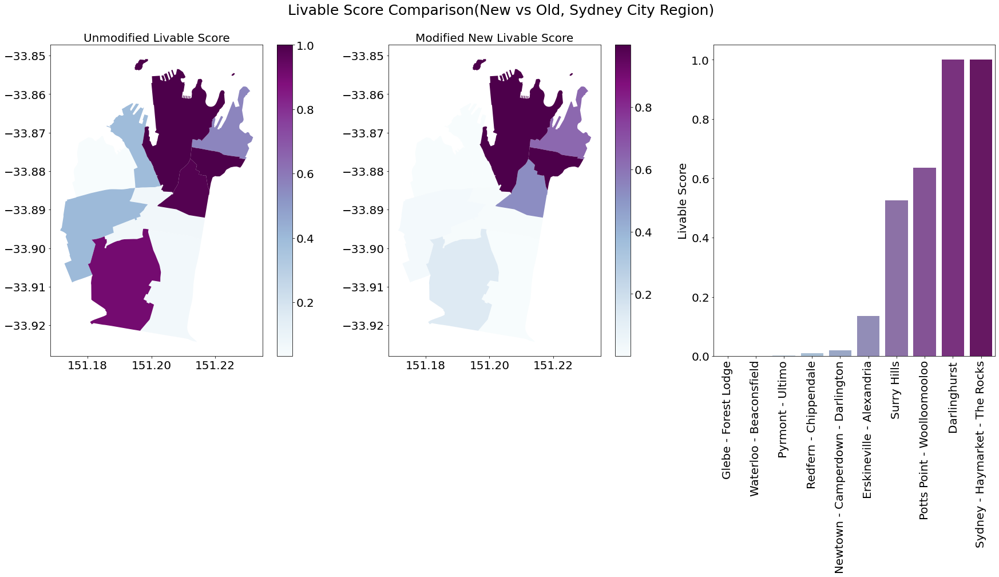

In [232]:
# create subplots for correlation scatter plot

fig, axes = plt.subplots(1, 3, figsize = (30, 10))
fig.suptitle('Livable Score Comparison(New vs Old, Sydney City Region)', fontsize = 25)
axes[0].set_title('Unmodified Livable Score', fontsize = 20)
axes[1].set_title('Modified New Livable Score', fontsize = 20)



vis_new_gdf.sort_values(by = 'new_livable_score', ascending = True, inplace = True)
vis_new_gdf.plot(ax = axes[0], column = 'old_livable_score', cmap = 'BuPu', figsize = (10, 10), legend = True)
new = vis_new_gdf.plot(ax = axes[1], column = 'new_livable_score', cmap = 'BuPu', figsize = (10, 10), legend = True)

# for idx, row in new.iterrows():
#     plt.annotate(s=row['sa2_name16'], xy=row['geometry'].centroid.coords[0], xytext=(-20, 20), textcoords='offset points', ha='right', va='bottom', bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5), arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))
#     pass


bar = sns.barplot(ax = axes[2], x = 'sa2_name16', y = 'new_livable_score', data = vis_new_gdf, palette = 'BuPu')
bar.set(xlabel = None, ylabel = 'Livable Score')
for item in bar.get_xticklabels():
    item.set_rotation(90)
fig.show()

/var/folders/z8/zm1gct552gb8700n_kq3pm9h0000gn/T/ipykernel_56312/1954146177.py:18: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



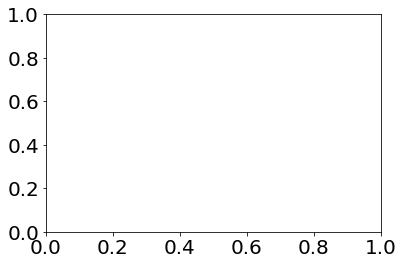

In [ ]:
vis_new_gdf

In [86]:
vis_new_gdf.sa2_name16

2                 Glebe - Forest Lodge
6                Redfern - Chippendale
9              Waterloo - Beaconsfield
5                     Pyrmont - Ultimo
3    Newtown - Camperdown - Darlington
7                          Surry Hills
4          Potts Point - Woolloomooloo
1            Erskineville - Alexandria
0                         Darlinghurst
8       Sydney - Haymarket - The Rocks
Name: sa2_name16, dtype: object

In [83]:
# find regions with highest score and lowest score regions
max_score_gsyd = vis_new_gdf['new_livable_score'].max()
max_name = vis_new_gdf[vis_new_gdf['new_livable_score'] == max_score_gsyd]['sa2_name16'].values[0]
min_score_gsyd = vis_new_gdf['new_livable_score'].min()
min_name = vis_new_gdf[vis_new_gdf['new_livable_score'] == min_score_gsyd]['sa2_name16'].values[0]
avg_score_gsyd = vis_new_gdf['new_livable_score'].mean()
print(f"CITY SYDNEY Liveable Scores:\nMax score found on {max_name} region: {round(max_score_gsyd,3)} \nMin score found on {min_name} region: {round(min_score_gsyd,3)}\nAverage score: {round(avg_score_gsyd,3)}")

CITY SYDNEY Liveable Scores:
Max score found on Sydney - Haymarket - The Rocks region: 1.0 
Min score found on Glebe - Forest Lodge region: 0.015
Average score: 0.314


/var/folders/z8/zm1gct552gb8700n_kq3pm9h0000gn/T/ipykernel_56312/247168855.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/z8/zm1gct552gb8700n_kq3pm9h0000gn/T/ipykernel_56312/247168855.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<AxesSubplot:>

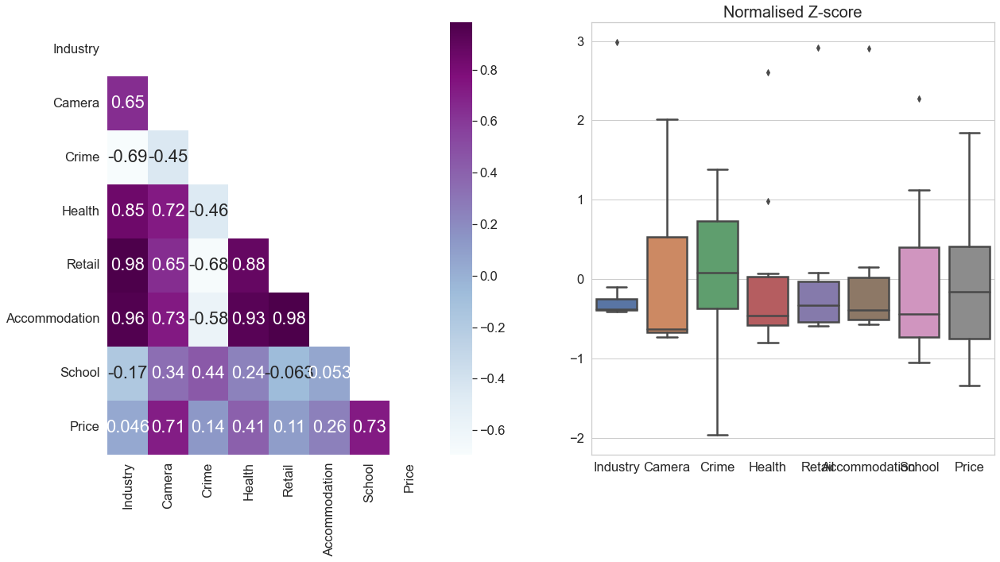

In [249]:
fig, axes = plt.subplots(1, 2, figsize = (20, 10))
#

box_df = z_table4[['z_industry_index_norm', 'z_camera_norm', 'z_crime_norm', 'z_health_norm', 'z_retail_norm', 'z_accomm_norm', 'z_school_norm', 'z_price_norm']]
box_df.rename(columns = {'z_industry_index_norm':'Industry', 'z_camera_norm':'Camera', 'z_crime_norm':'Crime', 'z_health_norm':'Health', 'z_retail_norm':'Retail', 'z_accomm_norm':'Accommodation', 'z_school_norm':'School','z_price_norm':'Price'}, inplace = True)
box = sns.boxplot(ax = axes[1], data = box_df, linewidth = 2.5)
box.set_title('Normalised Z-score', fontsize = 20)


z_corr = z_table3[['z_industry_index_norm', 'z_camera_norm', 'z_crime_norm', 'z_health_norm', 'z_retail_norm', 'z_accomm_norm', 'z_school_norm','z_price_norm']]
z_corr.rename(columns = {'z_industry_index_norm':'Industry', 'z_camera_norm':'Camera', 'z_crime_norm':'Crime', 'z_health_norm':'Health', 'z_retail_norm':'Retail', 'z_accomm_norm':'Accommodation', 'z_school_norm':'School','z_price_norm':'Price'}, inplace = True)
z_corr = z_corr.corr()
mask = np.triu(np.ones_like(z_corr, dtype = bool))
sns.set(rc = {'figure.figsize':(10, 10), 'font.size':22}, font_scale = 1.5, style = "whitegrid")
sns.heatmap(z_corr, mask = mask, annot = True, cmap = 'BuPu', ax = axes[0])

<AxesSubplot:>

# close database and connection

In [1]:
conn.close()
db.dispose()

NameError: name 'conn' is not defined

# END HERE